# Section 2.2: Feedforward Fully-Connected Neural Network

## Section 2.2.0: Package initialisations, environment configuration and function definitions

Import relevant packages:

In [1]:
import tensorflow as tf
from tensorflow.contrib.tensorboard.plugins import projector
import numpy as np
import scipy.misc
import math

import time
import datetime

# Non-interactive plotting
import matplotlib.pyplot as plt
from IPython import display

# Interactive plotting
from plotly import tools
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.offline import download_plotlyjs

Configure environment:

In [2]:
%config InlineBackend.figure_format = 'retina'
np.set_printoptions(precision=3)

# Global Variables
LOG_DIR = './Logs'

# Activate Plotly Offline for Jupyter
pyo.init_notebook_mode(connected=True)

Load notMNIST dataset into training, validation and testing datasets:

In [3]:
# Load notMNIST dataset
'''
 Training Set: 15,000 images
 Validation Set: 1,000 images
 Test Set: 2,724 images
 Images are 28 x 28 (normalised) pixels
'''
with np.load("notMNIST.npz") as data:
    Data, Target = data ["images"], data["labels"]
    
    # Set random seed
    np.random.seed(521)
    
    # Generate and shuffle random index
    
    randIndx = np.arange(len(Data))
    np.random.shuffle(randIndx)
    
    rawTestData = Data[randIndx][16000:]
    
    Data = Data[randIndx]/255.
    Target = Target[randIndx]
    
    # Generates one-hot version of target
    oneHot = np.zeros((Target.shape[0], 10))
    oneHot[np.arange(Target.shape[0]), Target] = 1
    Target = oneHot
    
    # Flatten arrays of dimension m x 28 x 28 into array of dimension m x 784
    Data = np.reshape(Data, (Data.shape[0], 784))
    
    # Standardizing inputs of dataset
    Data -= np.mean(Data, axis=0)
    Data /= np.std(Data, axis=0)
    
    # Partition data into training, validation and test datasets
    trainData, trainTarget = Data[:15000], Target[:15000]
    validData, validTarget = Data[15000:16000], Target[15000:16000]
    testData, testTarget = Data[16000:], Target[16000:]

### Define Plotly interactive graph generation:

In [4]:
def eta_IGraph(summary, title, filename, run_type):
    
    # Create subplot titles
    subplotTitle = ['Cross-Entropy Loss vs. Number of Epochs', 'Classification Error vs. Number of Epochs']
    
    # Define subplot figure
    figure = tools.make_subplots(rows=2, cols=1, subplot_titles=(subplotTitle))

    # Define colour list as per Plotly's default colour list
    colorList = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    
    # Create plot for each summary
    for i, run in enumerate(run_type):
        crossEntropyTrace = go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = summary[run + 'Error'],
            name = run,
            marker = {'color': colorList[i]}
        )
        accuracyTrace = go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = 1 - summary[run + 'Accuracy'],
            name = run,
            marker = {'color': colorList[i]}
        )
        figure.append_trace(crossEntropyTrace, 1, 1)
        figure.append_trace(accuracyTrace, 2, 1)
        
    # Update subplot axes titles
    figure['layout']['xaxis1'].update(title = 'Number of Epochs')
    figure['layout']['yaxis1'].update(title = 'Cross-Entropy Loss')
    figure['layout']['xaxis2'].update(title = 'Number of Epochs')
    figure['layout']['yaxis2'].update(title = 'Classification Error, %')
    
    # Update figure layout
    figure['layout'].update(
        height = 800,
        showlegend = False,
        title = title,
    )

    return pyo.iplot(figure, filename=filename)

## Create sprite image file

In [5]:
def build_sprites(testData, numRow, numCol):
    # Create empty sprite
    sprite = np.zeros((numRow*28, numCol*28))
    
    for i, data in enumerate(testData):
        # Calculate row and column indices
        row = i / numCol
        col = i % numCol
        # Update values by 'patches' of reshaped test data images
        sprite[28*row:28*(row+1), 28*col:28*(col+1)] = data.reshape(28,28)
    
    # Invert sprite grayscale colours
    sprite = - sprite
    return sprite
# sprite = build_sprites(rawTestData, 53, 53);
# scipy.misc.imsave('./sprite.png', sprite)

## Create metadata file

In [6]:
# with open('./metadata.tsv', 'w') as metadata_file:
#     for target in testTarget:
#         metadata_file.write('{}\n'.format(chr(ord('A') + np.argmax(target))))

### Create TensorFlow fully-connected neural network graph:

In [7]:
def build_FCNN(eta, lambda_, numHidLayers, layerUnits, dropout_rate):
    NUM_FEATURES = 784
    NUM_TARGET_CATEGORIES = 10
    '''
    - Builds a fully-connected neural network with numHidLayers hidden layers, with 
      layerUnits[i] in the i-th hidden layer
      
    Inputs:
        eta: Learning rate
        lambda_: L2 regularizer
        numHidLayers: Number of hidden layers
        layerUnits: List of number of units in each layer; len(layerUnits) == numHidLayer
    '''
    
    def connect_layers(h, numNextUnit, name='input_to_layer'):
        '''
        - Creates weights and biases to connect previous layer to next layer
        - Returns the weighted sum of inputs for to the next layer
        - Initializes weights using Xavier initialization.
        
        Inputs:
            hIn: Incoming activation tensor from previous layer
            numOut: Number of hidden units of next layer
            
        Outputs:
            z: Weighted sum of inputs into the next layer
        '''
        numPrevUnit = h.get_shape()[1]
        
        # Xavier initialization for weights
        xavier = tf.sqrt(3 / tf.cast(numPrevUnit + numNextUnit, tf.float32), name='xavier')
        
        W = tf.get_variable('weights', shape=[numPrevUnit, numNextUnit], \
                            initializer=tf.truncated_normal_initializer(stddev=xavier, seed=1))
        b = tf.get_variable('biases', shape=[1, numNextUnit], initializer=tf.constant_initializer(0.0))
        
        tf.add_to_collection(tf.GraphKeys.WEIGHTS, W)
        tf.add_to_collection(tf.GraphKeys.BIASES, b)
        
        return tf.add(tf.matmul(h, W), b, name=name)
    
    def build_layers(numHidLayers, layerUnits, dropout_rate):
        '''
        - Builds hidden layers and output layer
        
        Inputs:
            numHidLayers: Number of hidden layers
            layerUnits: List of number of units in each layer; len(layerUnits) == numHidLayer
            
        Output:
            zOut: Logits to output layer
        '''
        ### Builds hidden layers
        ZList = [] # Stores the inputs to the i-th layer
        hList = [] # Stores the activation of the i-th layer
        
        for i in range(numHidLayers):
            # Create the i-th hidden layer
            with tf.variable_scope('hidden_layer_%d' % i) as scope:
                # Calculates input to the i-th hidden layer
                # Uses placeholder tensor X instead of Z_(i-1) in connectLayers for the first hidden layer
                if i == 0:
                    ZList.append(connect_layers(X, layerUnits[i]))
                else:
                    ZList.append(connect_layers(hList[-1], layerUnits[i]))
                
                # Calculates ReLU activation of each layer
                hList.append(tf.nn.dropout(tf.nn.relu(ZList[i], name='hidden_activation'), keep_prob=1-dropout_rate, \
                                          name='dropped_activations'))
            
        # Adds activation variables into GraphKey.ACTIVATIONS collection
        for h in hList:
            tf.add_to_collection(tf.GraphKeys.ACTIVATIONS, h)
            
        ### Builds output layer
        with tf.variable_scope('output_layer'):
            ZList.append(connect_layers(hList[-1], NUM_TARGET_CATEGORIES, name='logits'))
        
        return ZList[numHidLayers]
    
    def _add_histogram(vars_):
        '''
        Helper function to add histogram tag to variables
        Input:
            var: variable to be tagged with histogram summary
        '''
        for var in vars_:
            tf.summary.histogram(var.op.name, var)
    
    
    #######################################
    #           Function begins           #
    #######################################
    mode = '/cpu:0'
    tf.set_random_seed(521)
    
    assert len(layerUnits) == numHidLayers
    
    with tf.device('/cpu:0'):
        with tf.name_scope('placeholders'):
            X = tf.placeholder(tf.float32, shape=[None, NUM_FEATURES], name='input_layer')
            Y = tf.placeholder(tf.float32, shape=[None, NUM_TARGET_CATEGORIES], name='target')
        
    with tf.device(mode):
        logits = build_layers(numHidLayers, layerUnits, dropout_rate) # Logits to output layer
        
        # Calculates prediction
        with tf.name_scope('prediction'):
            Yhat = tf.nn.softmax(logits, name='pred')
            YhatThres = tf.cast(tf.argmax(Yhat, axis=1, name='pred_threshold'), tf.float32)
        
    with tf.device('/cpu:0'):
        # Calculates training metrics
        with tf.name_scope('metrics'):
            # Calculates loss function
            with tf.name_scope('loss'):
                # Calculates cross-entropy
                with tf.name_scope('xent'):
                    xent = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(logits=logits, \
                                                                                  labels=Y, \
                                                                                  name='elem_x_entropy'), \
                                          name='total_x_entropy')
                # Calculates l2 loss
                with tf.name_scope('l2_loss'):
                    weights = tf.get_collection_ref(tf.GraphKeys.WEIGHTS)
                    biases = tf.get_collection_ref(tf.GraphKeys.BIASES)
                    actv = tf.get_collection_ref(tf.GraphKeys.ACTIVATIONS)
                    l2_loss = tf.multiply(lambda_ / 2, \
                                          tf.add_n([tf.nn.l2_loss(W) for W in weights]), name='total_l2_loss')
                # Calculates total loss
                with tf.name_scope('total_loss'):
                    error = tf.add(xent, l2_loss, name='total_loss')
                    tf.summary.scalar('loss', error)
            # Calculates accuracy
            with tf.name_scope('accuracy'):
                Ycollapsed = tf.cast(tf.argmax(Y, axis=1), tf.float32, name='target_reverse_one_hot')
                accuracy = tf.truediv(tf.reduce_sum(tf.cast(tf.equal(YhatThres, Ycollapsed) \
                                                            , tf.int32), \
                                                    name='total_matches'), \
                                      tf.shape(X)[0], \
                                      name='accuracy')
                tf.summary.scalar('accuracy', accuracy)
                
    with tf.device(mode):
        # Optimizer
        with tf.variable_scope('Adam'):
            optimizer = tf.train.AdamOptimizer(eta).minimize(error)
            
    with tf.device('/cpu:0'):
        # Add histogram summaries for variables of interest
        vars_ = []
        for var in [weights, biases, actv]:
            vars_.extend(var)
        _add_histogram(vars_)
        
        # Merge all summaries
        merged = tf.summary.merge_all()
    
    return X, Y, YhatThres, weights, logits, actv, error, accuracy, optimizer, merged

### Define training function:

In [8]:
def train_NN(etaList, numHidLayersList, layerUnitsList, sectionDir, batchSize=500, lambda_=3e-4, dropout_rate=0):    
    MAX_ITER = 3000
    '''
    - Returns the i-th batch of training data and targets
    - Generates a new, reshuffled batch once all previous batches are fed
    '''
    def get_next_training_batch(currentIter, randIdx):
        currentBatchNum = currentIter % (trainData.shape[0] / batchSize)
        if currentBatchNum == 0:
            np.random.shuffle(randIdx)
        lowerBoundIdx = currentBatchNum * batchSize
        upperBoundIdx = (currentBatchNum + 1) * batchSize 
        return trainData[randIdx[lowerBoundIdx:upperBoundIdx]], trainTarget[randIdx[lowerBoundIdx:upperBoundIdx]]
    
    # Generate updated plots for training and validation MSE
    def plot_err_graph(errList, param):
        label = '$\eta$ = ' + str(param)
        label_classification = ['train.', 'valid.']

        display.clear_output(wait=True)
        plt.figure(figsize=(8,5), dpi=200)
        
        for i, err in enumerate(errList):
            plt.plot(range(len(err)), err, '-', label=label+' '+label_classification[i])
        
        plt.axis([0, MAX_ITER, 0, np.amax(errList)])
        plt.legend()
        plt.show()
    
    # Calculates the ratio between the n-th average epoch MSE and the (n-1)-th average epoch MSE
    def average_epoch_err_ratio(validErr):
        averageN = np.mean(validErr[-epochSize:])
        averageNlessOne = np.mean(validErr[-epochSize*2:-epochSize])
        return averageN / averageNlessOne
    
    # Returns True if the average epoch validation MSE is at least 99.9% of the previous epoch average.
    # i.e. Returns True if the average learnings between epoch is less than +0.1%
    # Otherwise, returns False
    def should_stop_early(validErr):
        if validErr.shape[0] < 2 * epochSize:
            return False
        return True if (average_epoch_err_ratio(validErr) > 1) else False
    
    def embed_activations(var, name, writer):
        # Create variable to embed
        with tf.device('/cpu:0'):
            data_to_embed = tf.Variable(tf.zeros([testData.shape[0], var.get_shape()[1]]), name=name)
            assignment = data_to_embed.assign(var)

            # Define projector configurations
            config = projector.ProjectorConfig()

            # Add embedding
            embedding_config = config.embeddings.add()

            # Connect tf.Variable to embedding
            embedding_config.tensor_name = data_to_embed.name

            # Add metadata
            embedding_config.metadata_path = './metadata.tsv'

            # Add image sprites
            embedding_config.sprite.image_path = './sprite.png'
            embedding_config.sprite.single_image_dim.extend([28, 28])

            # Write projector_config.pbtxt in LOG_DIR
            projector.visualize_embeddings(writer, config)

            # Evaluate tf.Variable
            sess.run(assignment, feed_dict={X: testData})

            # Create save checkpoint
            saver = tf.train.Saver([data_to_embed])
            saver.save(sess, writeDir  + '/model_{}.ckpt'.format(name), MAX_ITER)
    
    # Start of function
    summaryList = []
    epochSize = trainData.shape[0] / batchSize
    
    assert sectionDir
    
    for eta in etaList:
        for i, layerUnits in enumerate(layerUnitsList):
            numHidLayers = numHidLayersList[i]
            
            # Set random seed
            np.random.seed(521)
            randIdx = np.arange(trainData.shape[0])
            
            # Prints run hyperparameters
            print 'Eta: ', eta
            print 'Hidden Layers: ', numHidLayers
            print 'Units in Layers: ', layerUnits
            print 'Dropout Rate: ', dropout_rate
            
            # Create directory paths
            chapterDir = '/Neural Network/Section ' + sectionDir + '/Eta_' + str(eta) + '/'
            currentTime = '{:%b%d %H_%M_%S}'.format(datetime.datetime.now())
            writeDir = LOG_DIR + chapterDir + currentTime

            # Build new graph
            tf.reset_default_graph() # Reset graph to prevent duplication of ops and variables
            X, Y, YhatThres, W, logits, actv, error, accuracy, optimizer, merged = build_FCNN(eta, lambda_, numHidLayers, layerUnits, dropout_rate)
            # Create saver
            # saver = tf.train.Saver()

            # Begin session
            with tf.Session(config=tf.ConfigProto(log_device_placement=False, allow_soft_placement=True)) as sess:
                # Log starting time
                startTime = time.time()

                # Create summary writer
                writer = tf.summary.FileWriter(writeDir, graph=sess.graph)

                # Initialise all TensorFlow variables
                tf.global_variables_initializer().run()

                # Create blank training, validation and test error arrays for the Session
                trainErr = np.array([])[:, np.newaxis]
                validErr = np.array([])[:, np.newaxis]
                testErr = np.array([])[:, np.newaxis]

                # Create blank training, validation and test accuracies arrays for the Session
                trainAcc = np.array([])[:, np.newaxis]
                validAcc = np.array([])[:, np.newaxis]
                testAcc = np.array([])[:, np.newaxis]
                
                # Create blank arrays to store weights for the Session
                weights_l0 = np.array([])[:, np.newaxis]

                # Runs update
                currentIter = 0
                while currentIter < MAX_ITER:
                    # To be memory efficient, save weights only at the start of each epoch
                    if currentIter % epochSize == 0:
                        if currentIter == 0:
                            weights_l0 = sess.run(W)[0][:,:, np.newaxis]
                        else:
                            weights_l0 = np.append(weights_l0, sess.run(W)[0][:,:, np.newaxis], axis=2)
                    
                    # Create training mini-batch stochastically from data
                    inputData, inputTarget = get_next_training_batch(currentIter, randIdx)

                    # Calculate error and accuracy metrics before optimization routine
                    currTrainErr, currTrainAcc = sess.run([error, accuracy], feed_dict={X: inputData, Y: inputTarget})
                    currValidErr, currValidAcc = sess.run([error, accuracy], feed_dict={X: validData, Y: validTarget})
                    currTestErr, currTestAcc = sess.run([error, accuracy], feed_dict={X: testData, Y: testTarget})
                    
                    # Append run values
                    trainErr = np.append(trainErr, currTrainErr)
                    validErr = np.append(validErr, currValidErr)
                    testErr = np.append(testErr, currTestErr)

                    trainAcc = np.append(trainAcc, currTrainAcc)
                    validAcc = np.append(validAcc, currValidAcc)
                    testAcc = np.append(testAcc, currTestAcc)
                    
                    # Perform optimization routine
                    if (currentIter + 1) % epochSize == 0:
                        # sess.run(optimizer, feed_dict={X: inputData, Y: inputTarget})
                        
                        # Configure run options and metadata
                        run_options = tf.RunOptions(trace_level=tf.RunOptions.FULL_TRACE)
                        run_metadata = tf.RunMetadata()

                        # Train graph whilst logging metadata
                        sess.run([optimizer, merged], \
                                 feed_dict={X:inputData, Y: inputTarget}, \
                                 options=run_options, run_metadata=run_metadata)

                        # Log training metadata and run summary
                        writer.add_run_metadata(run_metadata, 'step {}'.format(currentIter + 1))
                    else:
                        sess.run(optimizer, feed_dict={X: inputData, Y: inputTarget})
                    
                    # Calculate summaries
                    summaries = sess.run(merged, feed_dict={X: inputData, Y: inputTarget})
                    writer.add_summary(summaries, currentIter)

                    # Provide info on training progress at the end of every 10th epoch
                    if currentIter == 0 or currentIter % (epochSize * 10) == 0:
                        print 'epoch: %5.0f, currTrainErr: %10.2f, currValidErr: %10.2f' % \
                            ((currentIter + 1) / epochSize, currTrainErr, currValidErr)

                    # At the end of each epoch, check for early stopping possibilty. If so, break from while loop.
                    if (currentIter + 1) % epochSize == 0:
                        if should_stop_early(validErr):
                            print 'Exited from early stopping\n'
                            break

                    # At every 10 epochs, creates checkpoint for session

                    currentIter += 1

                    if currentIter == MAX_ITER:
                        print 'MAX_ITER reached\n'
                        
                # embed_activations(logits, 'logits', writer)
                writer.close()

            # Save session results as dictionary and appends to summaryList
            summaryList.append(
                {
                    'eta': eta,
                    'B': batchSize,
                    'lambda': lambda_,
                    'hidden_layers': numHidLayers,
                    'hidden_units': layerUnits,
                    'numIter': currentIter + 1 - epochSize,
                    'epoch': float(currentIter + 1) / epochSize - 1,
                    'trainError': trainErr[::epochSize].copy()[::],
                    'validError': validErr[::epochSize].copy()[::],
                    'testError': testErr[::epochSize].copy()[::],
                    'trainAccuracy': trainAcc[::epochSize].copy()[::],
                    'validAccuracy': validAcc[::epochSize].copy()[::],
                    'testAccuracy': testAcc[::epochSize].copy()[::],
                    'weights_layer_0': weights_l0
                }
            )

            # Print stats when a run is done
            print 'epochs: %.1f, currentIter: %d' % (summaryList[-1]['epoch'], summaryList[-1]['numIter'])
            print 'trainError: %.3f, validError: %.3f, testError: %.3f' % \
                    (summaryList[-1]['trainError'][-1], summaryList[-1]['validError'][-1], summaryList[-1]['testError'][-1])
            print 'Max trainAccuracy: %.3f, Max validAccuracy: %.3f, Max testAccuracy: %.3f' % \
                    (np.max(trainAcc), \
                     np.max(validAcc), \
                     np.max(testAcc))
            print 'runTime: %3.1fs\n\n' % (time.time() - startTime)

    return summaryList

## Section 2.2.1: Tuning Learning Rate, $\eta$

In [9]:
test_summary = train_NN(etaList=[1e-3], numHidLayersList=[1], layerUnitsList=[[1000]], sectionDir='Test1')

Eta:  0.001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
Exited from early stopping

epochs: 6.0, currentIter: 180
trainError: 0.149, validError: 0.349, testError: 0.404
Max trainAccuracy: 0.996, Max validAccuracy: 0.939, Max testAccuracy: 0.918
runTime: 50.8s




In [10]:
summary2_2_1 = train_NN(etaList=[1e-4, 1e-3, 1e-2], numHidLayersList=[1], layerUnitsList=[[1000]], sectionDir='2.2.1')

Eta:  0.0001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
epoch:    10, currTrainErr:       0.37, currValidErr:       0.37
epoch:    20, currTrainErr:       0.22, currValidErr:       0.35
Exited from early stopping

epochs: 21.0, currentIter: 630
trainError: 0.234, validError: 0.344, testError: 0.390
Max trainAccuracy: 0.986, Max validAccuracy: 0.930, Max testAccuracy: 0.915
runTime: 163.4s


Eta:  0.001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
Exited from early stopping

epochs: 6.0, currentIter: 180
trainError: 0.149, validError: 0.349, testError: 0.404
Max trainAccuracy: 0.996, Max validAccuracy: 0.939, Max testAccuracy: 0.918
runTime: 58.1s


Eta:  0.01
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
Exited from early stopping

epochs: 7.0, curr

### Produce interactive 2x1 subplots for best learning rate, $\eta$:

In [8]:
fig2_2_1 = eta_IGraph(summary2_2_1[1], \
                   '$ \\text{Graphs of Best Learning Rate } (\\eta=' + str(summary2_2_1[1]['eta']) + ')$', \
                   'A2Q2.2.1_bestEtaGraph', \
                    ['train', 'valid', 'test'])
fig2_2_1

This is the format of your plot grid:
[ (1,1) x1,y1 ]
[ (2,1) x2,y2 ]



# Section 2.3: Effects of Hyperparameters

## Section 2.3.1: Number of Hidden Units

In [9]:
summary2_3_1 = train_NN(etaList=[1e-3], numHidLayersList=[1, 1, 1], layerUnitsList=[[100], [500], [1000]], sectionDir='2.3.1')

Eta:  0.001
Hidden Layers:  1
Units in Layers:  [100]
Dropout Rate:  0
epoch:     0, currTrainErr:       3.34, currValidErr:       3.27
Exited from early stopping

epochs: 9.0, currentIter: 270
trainError: 0.15, validError: 0.30, testError: 0.36
Max trainAccuracy: 0.972, Max validAccuracy: 0.926, Max testAccuracy: 0.908
runTime: 17.2s


Eta:  0.001
Hidden Layers:  1
Units in Layers:  [500]
Dropout Rate:  0
epoch:     0, currTrainErr:       3.26, currValidErr:       3.18
Exited from early stopping

epochs: 6.0, currentIter: 180
trainError: 0.15, validError: 0.33, testError: 0.39
Max trainAccuracy: 0.992, Max validAccuracy: 0.929, Max testAccuracy: 0.916
runTime: 14.0s


Eta:  0.001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
Exited from early stopping

epochs: 6.0, currentIter: 180
trainError: 0.15, validError: 0.35, testError: 0.40
Max trainAccuracy: 0.996, Max validAccuracy: 0.939, Max testAccuracy: 0.919

Best validation error and test error comes from using 1000 hidden units.

## Section 2.3.2: Number of Layers

In [11]:
summary2_3_2 = train_NN(etaList=[1e-3], numHidLayersList=[1, 2], layerUnitsList=[[1000], [500, 500]], sectionDir='2.3.2')

Eta:  0.001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.88, currValidErr:       2.87
Exited from early stopping

epochs: 6.0, currentIter: 180
trainError: 0.149, validError: 0.349, testError: 0.404
Max trainAccuracy: 0.996, Max validAccuracy: 0.939, Max testAccuracy: 0.918
runTime: 49.8s


Eta:  0.001
Hidden Layers:  2
Units in Layers:  [500, 500]
Dropout Rate:  0
epoch:     0, currTrainErr:       2.62, currValidErr:       2.72
Exited from early stopping

epochs: 5.0, currentIter: 150
trainError: 0.168, validError: 0.339, testError: 0.425
Max trainAccuracy: 0.990, Max validAccuracy: 0.936, Max testAccuracy: 0.919
runTime: 40.1s




Using a deeper layer led to marginally better test classification accuracy.

### Produce plots for classification errors:

In [12]:
def hidden_units_IGraph(summaryList):
    traceList = []
    
    # Define colour list as per Plotly's default colour list
    colorList = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    
    for i, summary in enumerate(summaryList):
        traceList.append(go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = 1 - summary['trainAccuracy'],
            name = 'No. of Layers: ' + str(summary['hidden_layers']) + ' (Training)',
            line = {
                'color': colorList[i],
                'dash': 'dash'
            }
        ))
        
        traceList.append(go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = 1 - summary['validAccuracy'],
            name = 'No. of Layers: ' + str(summary['hidden_layers']) + ' (Validation)',
            marker = {'color': colorList[i]}
        ))
        
    data = go.Data(traceList)
        
    layout = go.Layout(
        title = 'Effect of layers on model performance',
        xaxis = {'title': 'Epoch'},
        yaxis = {'title': 'Classification Error, %'}
    )
    
    figure = go.Figure(data=data, layout=layout)
    
    return py.iplot(figure, filename='A2Q2.3.1_EffectOfLayers')
        
fig2_3_2 = hidden_units_IGraph(summary2_3_2)
fig2_3_2

# Section 2.4: Regularization

## Section 2.4.1: Dropout

In [18]:
summary2_4_1 = train_NN(etaList=[1e-3], numHidLayersList=[1], layerUnitsList=[[1000]], \
                        dropout_rate=0.5, sectionDir='2.4.1')

Eta:  0.001
Hidden Layers:  1
Units in Layers:  [1000]
Dropout Rate:  0.5
epoch:     0, currTrainErr:       3.28, currValidErr:       3.30
Exited from early stopping

epochs: 9.0, currentIter: 270
trainError: 0.185, validError: 0.373, testError: 0.458
Max trainAccuracy: 0.980, Max validAccuracy: 0.932, Max testAccuracy: 0.912
runTime: 77.7s




### Plotting classification errors of NN model with dropout:

In [13]:
def dropout_IGraph(summaryList):
    traceList = []
    
    # Define colour list as per Plotly's default colour list
    colorList = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    
    # Define legend titles
    legend_title = ['50% dropout ', 'No dropout ']
    
    for i, summary in enumerate(summaryList):
        traceList.append(go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = 1 - summary['trainAccuracy'],
            name = legend_title[i] + '(Training)',
            line = {
                'color': colorList[i],
                'dash': 'dash'
            }
        ))
        
        traceList.append(go.Scatter(
            x = range(int(summary['epoch']) + 1),
            y = 1 - summary['validAccuracy'],
            name = legend_title[i] + '(Validation)',
            marker = {'color': colorList[i]}
        ))
        
    data = go.Data(traceList)
        
    layout = go.Layout(
        title = 'Effect of Dropout on Model Performance',
        xaxis = {'title': 'Epoch'},
        yaxis = {'title': 'Classification Error, %'}
    )
    
    figure = go.Figure(data=data, layout=layout)
    
    return py.iplot(figure, filename='A2Q2.4.1_EffectOfDropout')
        
fig2_4_1 = dropout_IGraph([summary2_4_1[0], summary2_2_1[1]])
fig2_4_1

#### Observed effects of dropout:

From the graph above, employing dropout of 50% in the model leads to no significant changes in the model performance. The only difference noted was that the model with dropout took fewer number of epochs before reaching early stopping.




## Section 2.4.2: Visualisation

#### Create visualisation method:

In [15]:
'''
Creates four plots at 25%, 50%, 75% and 100% of training epochs. 
Each plot consists of 40x25 subplots of 28x28 heatmaps to represent each of the 1000x28x28 weights.
'''
def visualise_weights(weights, hasDropout):
    # Mark start time
    startTime = time.time()
    
    # Calculate total number of epochs ran
    numEpochs = weights.shape[2]
    
    # Loop through 25%, 50%, 75%, 100% of runs
    for i in range(4):
        fig = plt.figure(figsize=(16,20))
        # Loop through all 1000 weights in the hidden layer
        for j in range(weights.shape[1]):
            # Plots on 40x25 subplot
            plt.subplot(40, 25, j + 1)
            
            # Create 28x28 heatmap of data
            plt.imshow(np.reshape(weights[:, j:j+1, int((i + 1) * numEpochs / 4) - 1], (28, 28)), cmap='gray')
            
            # Turn off axes for each subplot
            plt.gca().axis('off')
        
        # Place subplot main title
        fig.text(0.5, 0.9, str((i + 1) * 100 / 4) + '%', fontdict=dict(fontsize=20), \
                 transform=fig.transFigure, horizontalalignment='center')
        plt.show()
        
    # Print total plot duration
    print 'Duration: %.1fs' % (time.time() - startTime)

#### Visualise weights for model without dropout:

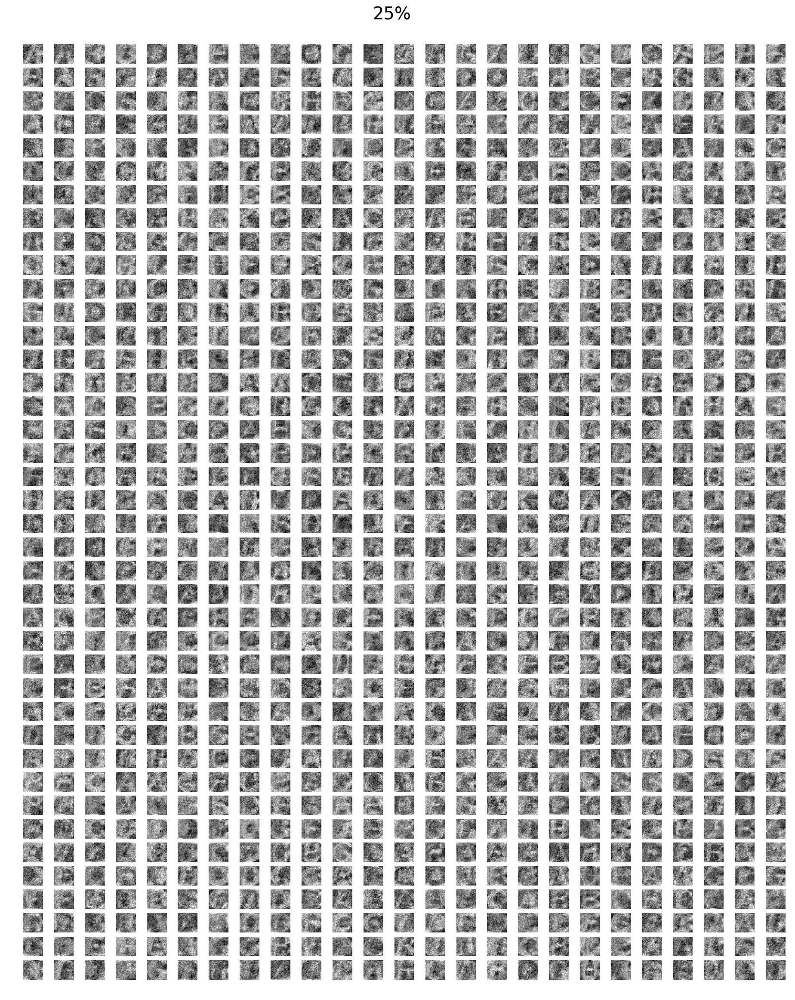

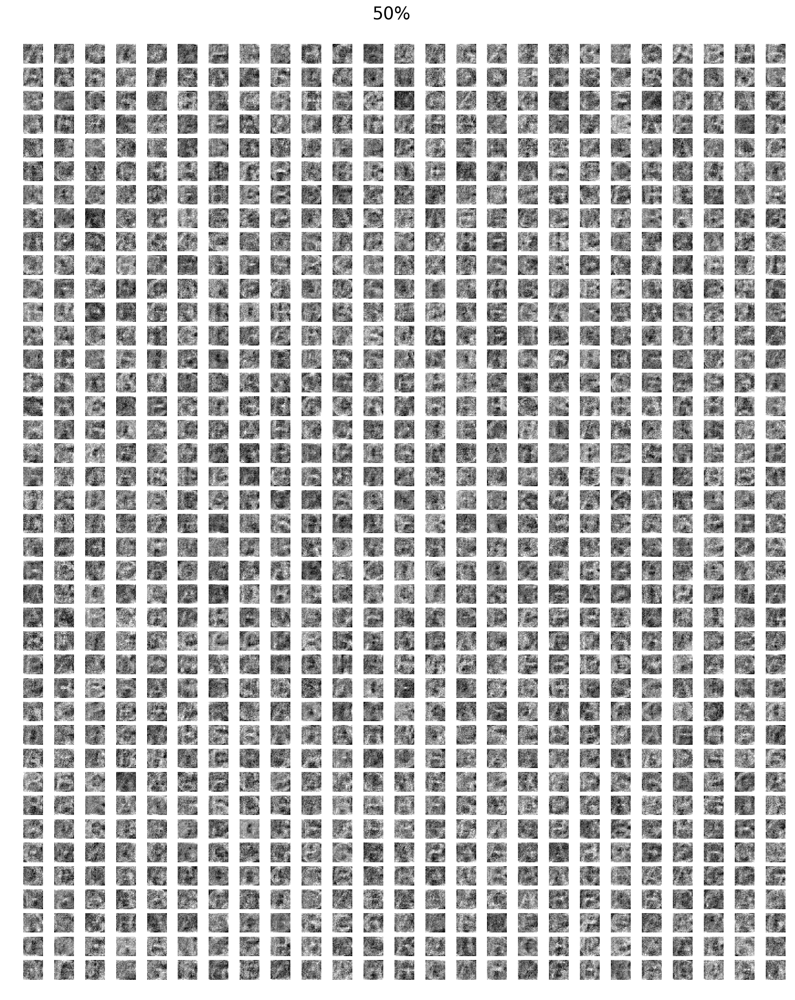

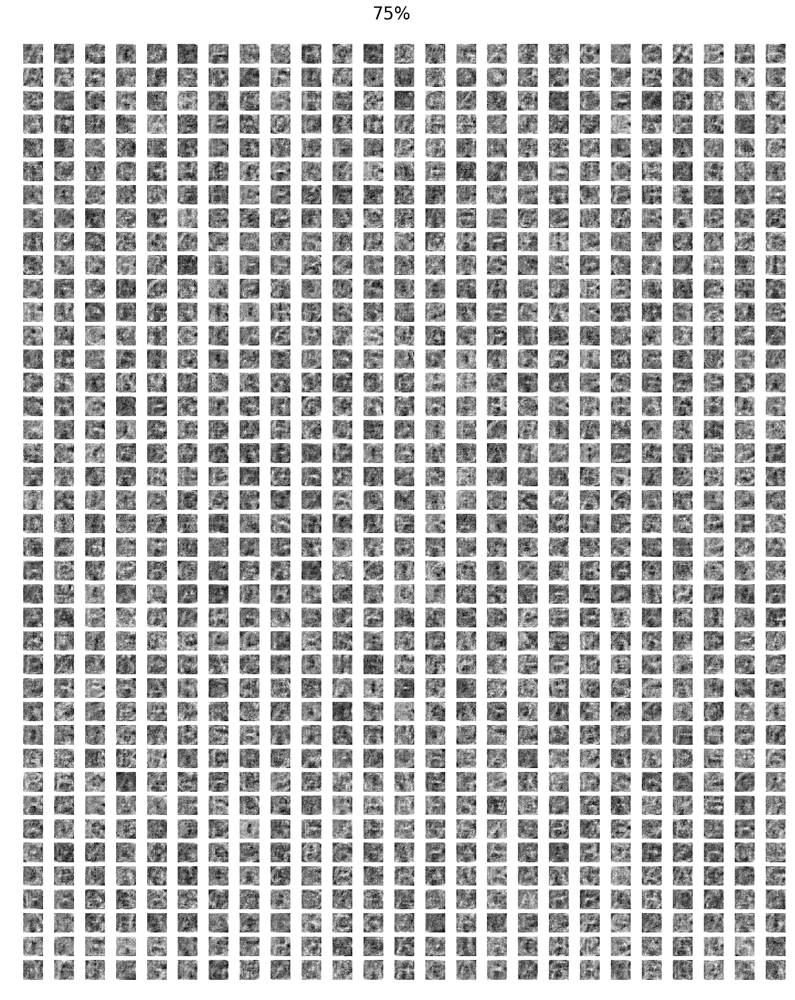

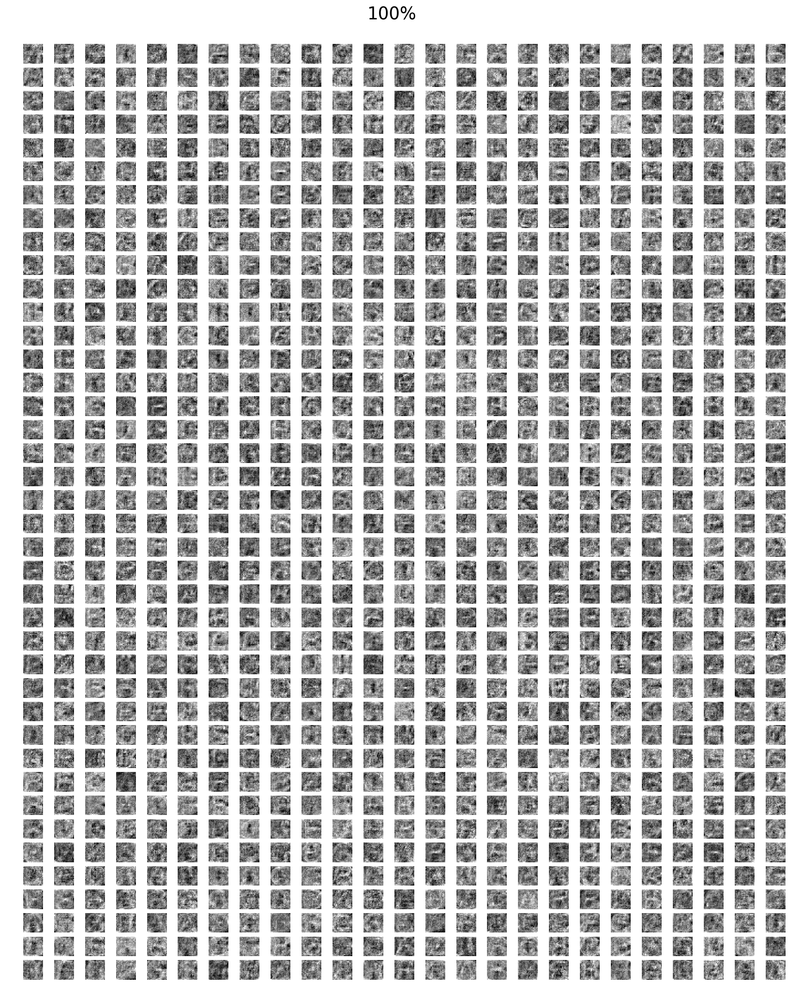

Duration: 522.7s


In [16]:
visualise_weights(summary2_2_1[-1]['weights_layer_0'], hasDropout=False)

#### Visualise weights for model with dropout:

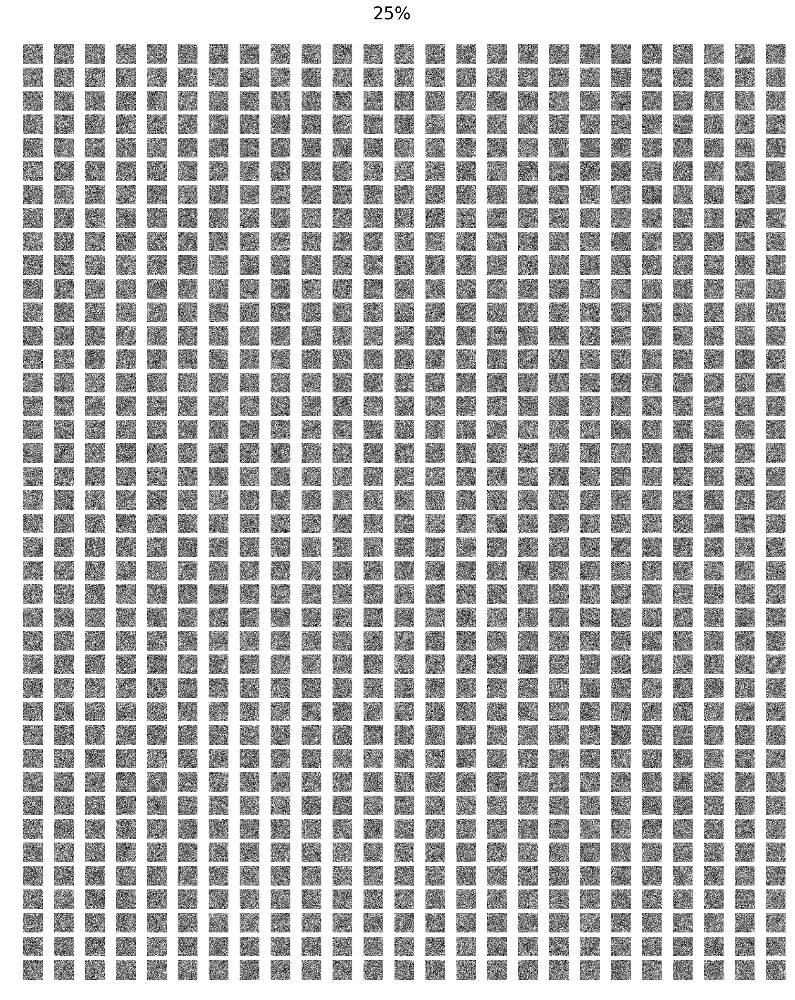

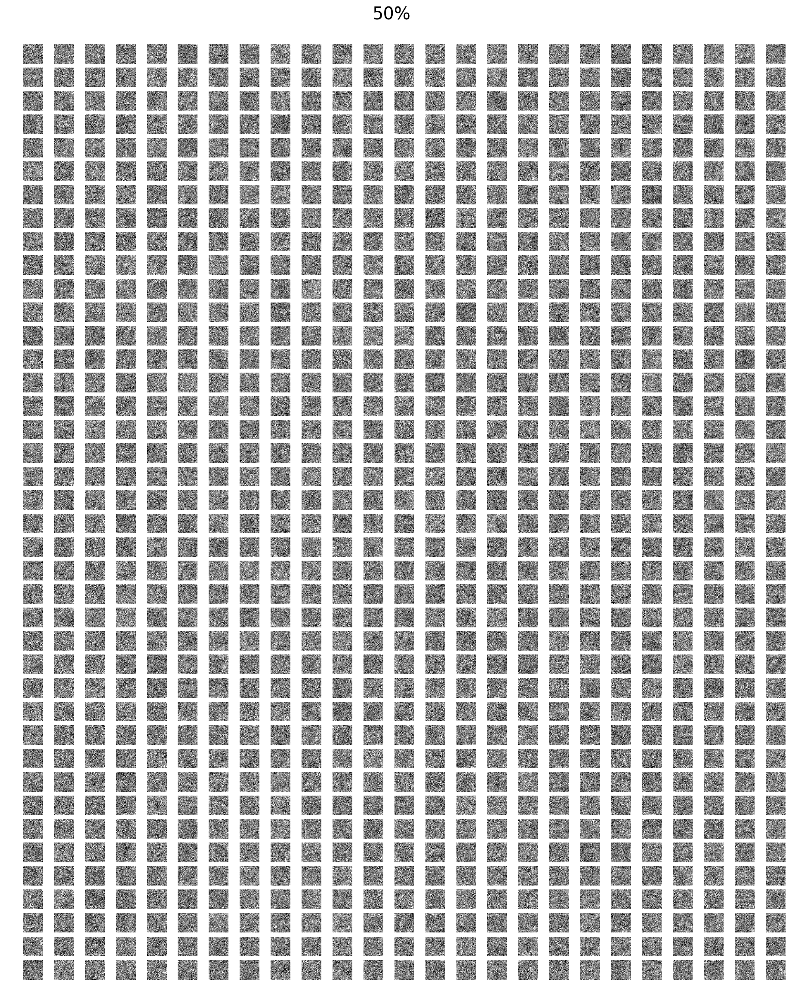

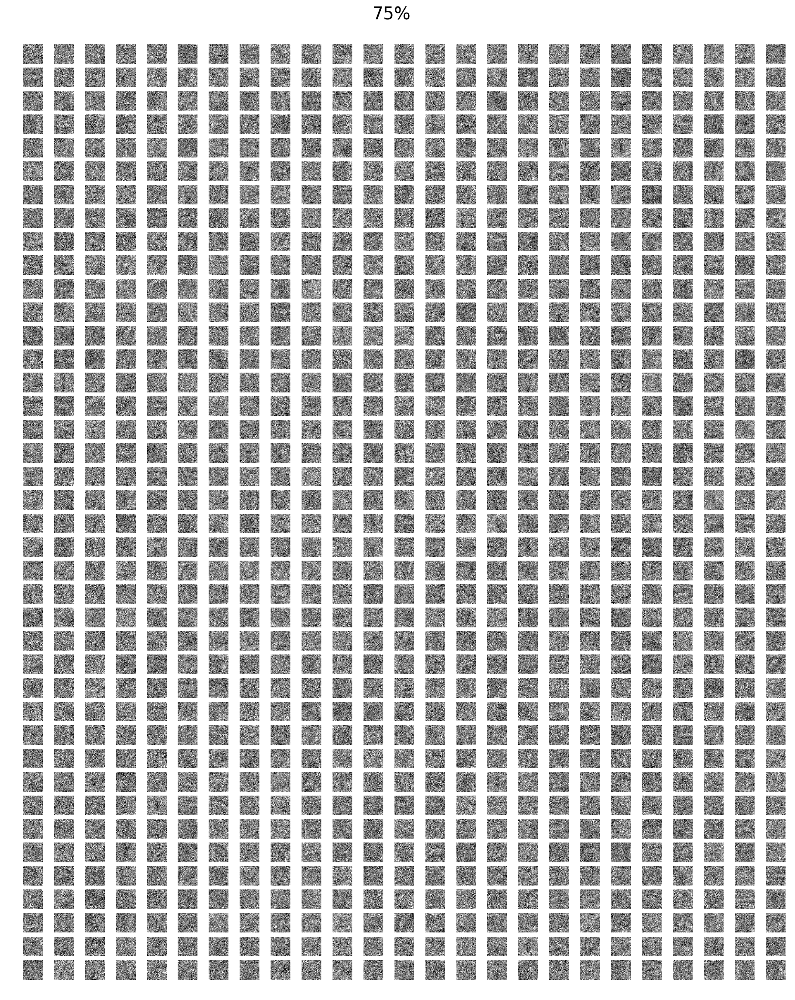

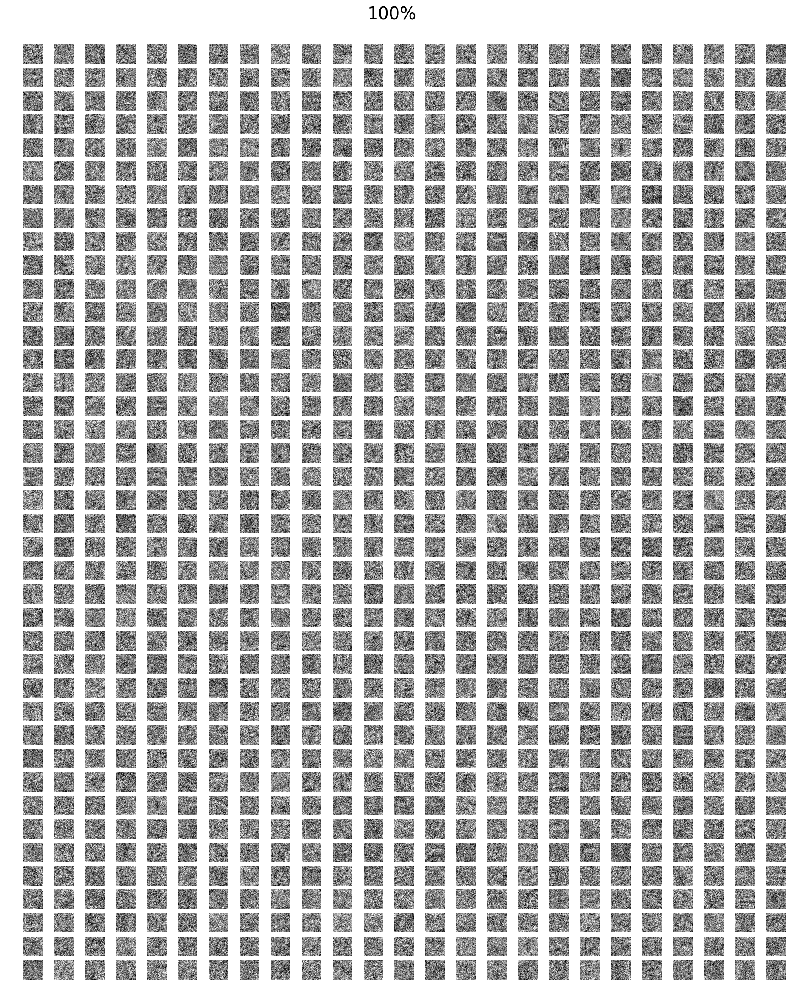

Duration: 548.9s


In [19]:
visualise_weights(summary2_4_1[-1]['weights_layer_0'], hasDropout=True)

# Section 2.5: Exhaustive Search for Best Hyperparameters

## Section 2.5.1: Random Search

In [76]:
def run_exhaustive_search():
    '''
    Performs exhaustive search on hyperparameters by sampling from a random uniform distribution. 
    Seed number used is a concatenation of the last two digits of both our student numbers. ('37' + '93')
    
    Selects random values for:
        ln(eta):            [-7.5, -4.5]
        hidden layers:      [1, 5]
        hidden layer units: [100, 500]
        ln(lambda):         [-9, -6]
        dropout:            'yes' or 'no'
    '''
    # Set random seed
    np.random.seed(3793)
    
    # Create placeholders to record randomly generated hyperparameters
    etaList = []
    layersList = []
    unitsList = []
    lambdaList = []
    dropoutList = []
    summary2_5_1 = []
    
    # Assign randomly generated values for model hyperparameters
    for i in range(5):
        # Randomly sample values for hyperparameters
        etaList.append(np.exp(np.random.uniform(-7.5, -4.5, size=1)))
        layersList.append(np.random.randint(1, 6, size=1))
        unitsList.append(np.random.randint(100, 501, size=layersList[i]))
        lambdaList.append(np.exp(np.random.uniform(-9, -6, size=1)).astype(np.float32))
        dropoutList.append(np.random.randint(0, 2))
    
    # Train each model
    for i in range(5):
        # Perform training run
        summary2_5_1.append(train_NN(etaList[i], layersList[i], [unitsList[i]], \
                                     dropout_rate=0.5*dropoutList[i], lambda_=lambdaList[i], sectionDir='2.5.1')[0])
        
    return summary2_5_1
        
summary2_5_1 = run_exhaustive_search()

Eta:  0.000705122447501
Hidden Layers:  5
Units in Layers:  [236 438 326 298 496]
Dropout Rate:  0.0
epoch:     0, currTrainErr:       3.28, currValidErr:       3.28
epoch:    10, currTrainErr:       0.59, currValidErr:       0.84
epoch:    20, currTrainErr:       0.38, currValidErr:       0.67
epoch:    30, currTrainErr:       0.26, currValidErr:       0.55
Exited from early stopping

epochs: 35.0, currentIter: 1050
trainError: 0.220, validError: 0.525, testError: 0.614
Max trainAccuracy: 1.000, Max validAccuracy: 0.941, Max testAccuracy: 0.923
runTime: 84.0s


Eta:  0.00684892632217
Hidden Layers:  4
Units in Layers:  [409 381 103 388]
Dropout Rate:  0.5
epoch:     0, currTrainErr:       4.10, currValidErr:       4.13
Exited from early stopping

epochs: 8.0, currentIter: 240
trainError: 0.930, validError: 0.911, testError: 0.984
Max trainAccuracy: 0.896, Max validAccuracy: 0.887, Max testAccuracy: 0.871
runTime: 25.2s


Eta:  0.00497241806012
Hidden Layers:  5
Units in Layers:  [480 

In [19]:
def visualise_weights_mean(weights, hasDropout):
    '''
    Create a 32x32 grid of cells. Each cell contains a 28x28 grid of grayscale pixels to visualise the 
    incoming weights to each hidden unit of layer 0.
    
    Weights dimension of numIn x numOut x epochs where
        numIn: number of inputs to layer
        numOut: number of units in layer
        epochs: number of epochs
    '''
    
    def prepare_each_weight(weight):
        '''
        Manipulate weights values to be suitable for grayscale encoding. 
        Return each weight as a 28x28 grid of grayscale values.
        
        Input:
            weight: weights to a single hidden unit (dim: numIn x 1)
        
        Output:
            Rescaled weights that are reshaped into dimensions of 28x28
        '''
        weight += np.min(weight)
        weight /= np.max(weight)
        weight *= 255
        weight.astype(int)
        return weight.reshape((28, 28))
    
    def prepare_weights(weights):
        '''
        Average weights along the numIn dimension, and scale values to be suitable for grayscale encoding
        Return weight as a 32x32 grid of grayscale values
        '''
        weights = np.mean(weights, axis=0)
        weights -= np.min(weights)
        weights *= 255 / np.max(weights)
        weights = np.append(weights, np.zeros((1, 24)))
        return weights.astype(int).reshape((32, 32))
    
    '''
    Creates 32x32 main grid using Plotly subplots
    '''
    
    # Create figure with 2x2 subplots
    figure = tools.make_subplots(rows=2, cols=2, subplot_titles=('25\%', '50\%', '75\%', '100\%'))
    
    # Prepare data for plotting
    numEpochs = weights.shape[2]
        
    # Define colour list as per Plotly's default colour list
    colorList = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    
    for i in range(4):
        trace = go.Heatmap(
            z = prepare_weights(weights[:,:,numEpochs * i / 4]),
            x = range(32),
            y = range(32),
            showscale = True if i == 0 else False,
            colorscale = [[0, 'rgb(255,255,255)'], [1, colorList[0 if hasDropout == True else 1]]]
        )
        figure.append_trace(trace, i / 2 + 1, i % 2 + 1)
    
    figure['layout'].update(
        height=900, width=900, showlegend=False,
        title='Layer 1 Weights Visualisation (' + ('without' if hasDropout == False else 'with') + ' Dropout)'
    )
        
    return py.iplot(figure, filename='A2Q2.4.2_Weights_Visualisation' + ('_without' if hasDropout == False else '') + '_Dropout')    

In [13]:
def visualise_weights(weights, hasDropout):
    '''
    Create a 32x32 grid of cells. Each cell contains a 28x28 grid of grayscale pixels to visualise the 
    incoming weights to each hidden unit of layer 0.
    
    Weights dimension of numIn x numOut x epochs where
        numIn: number of inputs to layer
        numOut: number of units in layer
        epochs: number of epochs
    '''
    
    def prepare_unit_weights(weight):
        '''
        Manipulate weights values to be suitable for grayscale encoding. 
        Return each weight as a 28x28 grid of grayscale values.
        
        Input:
            weight: weights to a single hidden unit (dim: numIn x 1)
        
        Output:
            Rescaled weights that are reshaped into dimensions of 28x28
        '''
        weight += np.min(weight)
        weight /= np.max(weight)
        weight *= 255
        return weight.astype(int).reshape((28, 28))
    
    def prepare_weights(weights):
        '''
        Average weights along the numIn dimension, and scale values to be suitable for grayscale encoding
        Return weight as a 32x32 grid of grayscale values
        '''
        weights = np.mean(weights, axis=0)
        weights -= np.min(weights)
        weights *= 255 / np.max(weights)
        weights = np.append(weights, np.zeros((1, 24)))
        return weights.astype(int).reshape((32, 32))
    
    '''
    Creates 32x32 main grid using Plotly subplots
    '''
    
    # Prepare data for plotting
    numEpochs = weights.shape[2]
    
    # Define colour list as per Plotly's default colour list
    colorList = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']
    
    # Define list to store each of 4 plots
    plotList = []
        
    for i in range(1):
        # Create figure with 40x25 subplots
        figure = tools.make_subplots(rows=50, cols=10)
        
        for j, unit_weights in enumerate(np.transpose(weights[:, :, numEpochs * i / 4])):
            if j == 500:
                break
            trace = go.Heatmap(
                z = prepare_unit_weights(unit_weights),
                x = range(28),
                y = range(28),
                showscale = False,
                colorscale = [[0, 'rgb(255,255,255)'], [1, colorList[0 if hasDropout == True else 1]]]
            )
            figure.append_trace(trace, j / 10 + 1, j % 10 + 1)
            figure['layout']['xaxis'+str(j+1)].update(
                autorange=True,
                showgrid=False,
                zeroline=False,
                showline=False,
                autotick=True,
                ticks='',
                showticklabels=False
            )
            
            figure['layout']['yaxis'+str(j+1)].update(
                autorange=True,
                showgrid=False,
                zeroline=False,
                showline=False,
                autotick=True,
                ticks='',
                showticklabels=False
            )
            
            if j % 50 == 0:
                print 'Appended heatmap: ', j
    
        figure['layout'].update(
            height=900, width=900, showlegend=False,
            title='Layer 1 Weights Visualisation (' + \
                ('without' if hasDropout == False else 'with') + ' Dropout)'
        )
        
        plotList.append(py.iplot(figure, filename='A2Q2.4.2_Weights_Visualisation' + ('_without' if hasDropout == False else '') + '_Dropout'))
        
    return plotList